# Tooling and setup

In [2]:
import shapely
import fiona
import geopandas as gpd
import pandas as pd
import osmnx as ox
from IPython.display import IFrame
%matplotlib inline
ox.config(log_console=True)

import space_syntax_utils as ssu
from shapely.geometry import Point, LineString
import folium

2021-11-03 18:30:59 Configured OSMnx 1.1.1
2021-11-03 18:30:59 HTTP response caching is on


In [3]:
G = ox.graph_from_address("Marktplatz, St. Gallen, Switzerland", dist=5000, network_type='walk')

# Optimizing the graph for walking intersections
G2 = ox.consolidate_intersections(ox.project_graph(G), rebuild_graph=True, tolerance=2.5, dead_ends=False)
G2 = ox.project_graph(G2, to_crs="EPSG:4326")
ox.plot_graph_folium(G2, popup_attribute='name', weight=2, color='#8b0000')

2021-11-03 18:30:59 Retrieved response from cache file "cache/0b40c2ea864ffbb4390fad97e8236f25af77f540.json"
2021-11-03 18:30:59 Geocoded "Marktplatz, St. Gallen, Switzerland" to (47.4259551, 9.3742457)
2021-11-03 18:30:59 Created bbox 5000 m from (47.4259551, 9.3742457): 47.47092111677465,47.38098908322536,9.440710142823448,9.30778125717655
2021-11-03 18:30:59 Projected GeoDataFrame to +proj=utm +zone=32 +ellps=WGS84 +datum=WGS84 +units=m +no_defs +type=crs
2021-11-03 18:30:59 Projected GeoDataFrame to epsg:4326
2021-11-03 18:30:59 Projected GeoDataFrame to +proj=utm +zone=32 +ellps=WGS84 +datum=WGS84 +units=m +no_defs +type=crs
2021-11-03 18:30:59 Projected GeoDataFrame to epsg:4326
2021-11-03 18:30:59 Requesting data within polygon from API in 1 request(s)
2021-11-03 18:30:59 Retrieved response from cache file "cache/a3cda8dc450b074cec42c5432cbe6bdb91b3dd6d.json"
2021-11-03 18:30:59 Got all network data within polygon from API in 1 request(s)
2021-11-03 18:30:59 Creating graph from 

/var/folders/w_/pfhp5d154sb5rj9v86zwf35r0000gp/T/ipykernel_77581/1269087363.py:4: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  G2 = ox.consolidate_intersections(ox.project_graph(G), rebuild_graph=True, tolerance=2.5, dead_ends=False)


2021-11-03 18:31:11 Created edges GeoDataFrame from graph
2021-11-03 18:31:11 Created nodes GeoDataFrame from graph
2021-11-03 18:31:11 Projected GeoDataFrame to EPSG:4326
2021-11-03 18:31:12 Created edges GeoDataFrame from graph
2021-11-03 18:31:12 Projected GeoDataFrame to EPSG:4326
2021-11-03 18:31:12 Created graph from node/edge GeoDataFrames
2021-11-03 18:31:12 Projected graph with 7538 nodes and 21374 edges
2021-11-03 18:31:12 Created edges GeoDataFrame from graph


2021-11-03 18:31:26 Begin plotting the graph...
2021-11-03 18:31:26 Created edges GeoDataFrame from graph
2021-11-03 18:31:27 Created nodes GeoDataFrame from graph


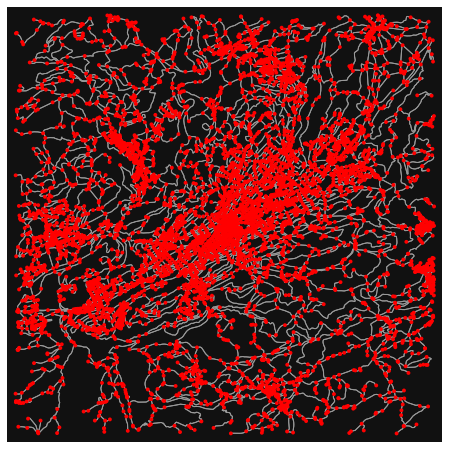

2021-11-03 18:31:27 Finished plotting the graph


In [4]:
fig, ax = ox.plot_graph(G2, node_color='r')

In [7]:
%cd ..

/Users/thorben.cividi/Developer/st-gallen-urban-indicators


In [8]:
file_name = 'stgallen_region'
ox.save_graph_geopackage(G2, filepath=f'data/spacesyntax/{file_name}.gpkg')
ssu.gpkg_to_dxf(f'data/spacesyntax/{file_name}.gpkg', f'data/spacesyntax/{file_name}.dxf')
ssu.run_segment_analysis(f'data/spacesyntax/{file_name}.dxf', f'data/spacesyntax/{file_name}.graph')

2021-11-03 18:32:55 Created edges GeoDataFrame from graph
2021-11-03 18:32:55 Converted MultiDiGraph to undirected MultiGraph
2021-11-03 18:32:55 Created nodes GeoDataFrame from graph
2021-11-03 18:32:56 Created edges GeoDataFrame from graph
2021-11-03 18:32:57 Saved graph as GeoPackage at "data/spacesyntax/stgallen_region.gpkg"
converting data/spacesyntax/stgallen_region.gpkg to data/spacesyntax/stgallen_region.dxf...
importing data/spacesyntax/stgallen_region.dxf...
converting data/spacesyntax/stgallen_region.dxf to segment map...
Loading graph data/spacesyntax/{file_name}.graph ok
 ok
Writing out result... ok
calculating 500m, 1km, 2.5km and 5km angular segment analysis...
Loading graph data/spacesyntax/{file_name}.graph ok
Running segment analysis... ok
Writing out result... ok
